<a href="https://colab.research.google.com/github/EllieZhangy/Artwork-Classification-and-Style-Transfer/blob/main/Classification.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Final Project
## Task1: Classification

In [ ]:
import warnings
warnings.filterwarnings("ignore")

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


In [ ]:
# Import libraries
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import json
import os
from tqdm import tqdm, tqdm_notebook
import random
import os
import shutil

import tensorflow as tf
from tensorflow.keras.models import Sequential, Model
from tensorflow.keras.layers import *
from tensorflow.keras.optimizers import *
from tensorflow.keras.applications import *
from tensorflow.keras.callbacks import *
from tensorflow.keras.initializers import *
from tensorflow.keras.preprocessing.image import ImageDataGenerator


## 1.Data Processing

### 1.1 Sampling：artists having more than 200 paintings

In [ ]:
artists = pd.read_csv('/content/drive/MyDrive/DL_Final/artists.csv')
artists.shape

(50, 8)

In [ ]:
# Sort artists by number of paintings
artists = artists.sort_values(by=['paintings'], ascending=False)

# Create a dataframe with artists having more than 200 paintings
artists_top = artists[artists['paintings'] >= 200].reset_index()
artists_top = artists_top[['name', 'paintings']]

#artists_top['class_weight'] = max(artists_top.paintings)/artists_top.paintings
artists_top['class_weight'] = artists_top.paintings.sum() / (artists_top.shape[0] * artists_top.paintings)
artists_top

,name,paintings,class_weight
0,Vincent van Gogh,877,0.445631
1,Edgar Degas,702,0.556721
2,Pablo Picasso,439,0.890246
3,Pierre-Auguste Renoir,336,1.163149
4,Albrecht Dürer,328,1.191519
5,Paul Gauguin,311,1.256650
6,Francisco Goya,291,1.343018
7,Rembrandt,262,1.491672
8,Alfred Sisley,259,1.508951
9,Titian,255,1.532620


In [ ]:
# Set class weights - assign higher weights to underrepresented classes
class_weights = artists_top['class_weight'].to_dict()
class_weights

{0: 0.44563076604125634,
 1: 0.5567210567210568,
 2: 0.8902464278318493,
 3: 1.1631493506493507,
 4: 1.1915188470066518,
 5: 1.2566501023092662,
 6: 1.3430178069353327,
 7: 1.491672449687717,
 8: 1.5089505089505089,
 9: 1.532620320855615,
 10: 1.6352225180677062}

In [ ]:
# There is some problem recognizing 'Albrecht_Dürer' (don't know why, worth exploring)
# So I'll update this string as directory name to df's
updated_name = "Albrecht_Dürer".replace("_", " ")
artists_top.iloc[4, 0] = updated_name

artists_top

,name,paintings,class_weight
0,Vincent van Gogh,877,0.445631
1,Edgar Degas,702,0.556721
2,Pablo Picasso,439,0.890246
3,Pierre-Auguste Renoir,336,1.163149
4,Albrecht Dürer,328,1.191519
5,Paul Gauguin,311,1.256650
6,Francisco Goya,291,1.343018
7,Rembrandt,262,1.491672
8,Alfred Sisley,259,1.508951
9,Titian,255,1.532620


### 1.2 Explore images of top artists

In [ ]:
images_dir = '/content/drive/MyDrive/DL_Final/images/images'
artists_top_name = artists_top['name'].str.replace(' ', '_').values
destination_path = '/content/drive/MyDrive/Deep Learning/tops_images' # move the selected images to another folder

# Create the destination directory if it doesn't exist
os.makedirs(destination_path, exist_ok=True)

# Iterate through the artist names
for name in artists_top_name:
    src_path = os.path.join(images_dir, name)
    dest_path = os.path.join(destination_path, name)

    if os.path.exists(src_path):
        print("Found -->", src_path)

        # Copy the folder and its contents to the destination directory
        shutil.copytree(src_path, dest_path)
    else:
        print("Not found -->", src_path)

Found --> /content/drive/MyDrive/DL_Final/images/images/Vincent_van_Gogh
Found --> /content/drive/MyDrive/DL_Final/images/images/Edgar_Degas
Found --> /content/drive/MyDrive/DL_Final/images/images/Pablo_Picasso
Found --> /content/drive/MyDrive/DL_Final/images/images/Pierre-Auguste_Renoir
Found --> /content/drive/MyDrive/DL_Final/images/images/Albrecht_Dürer
Found --> /content/drive/MyDrive/DL_Final/images/images/Paul_Gauguin
Found --> /content/drive/MyDrive/DL_Final/images/images/Francisco_Goya
Found --> /content/drive/MyDrive/DL_Final/images/images/Rembrandt
Found --> /content/drive/MyDrive/DL_Final/images/images/Alfred_Sisley
Found --> /content/drive/MyDrive/DL_Final/images/images/Titian
Found --> /content/drive/MyDrive/DL_Final/images/images/Marc_Chagall


In [ ]:
# start from here next time
images_dir = '/content/drive/MyDrive/Deep Learning/tops_images'
artists_top_name = artists_top['name'].str.replace(' ', '_').values

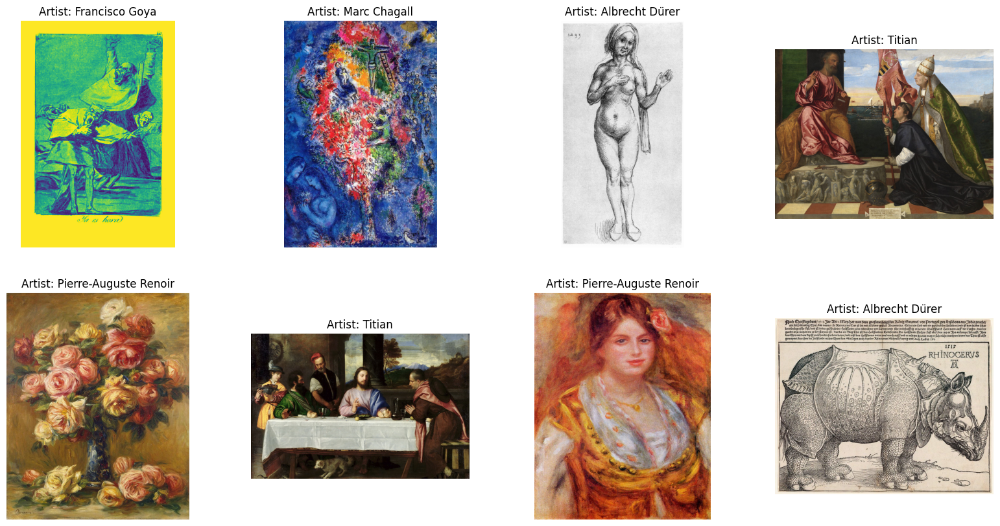

In [ ]:
import random
import os
import matplotlib.pyplot as plt

n_rows = 2
n_columns = 4
fig, axes = plt.subplots(n_rows, n_columns, figsize=(20, 10))

for row in range(n_rows):
    for col in range(n_columns):
        random_artist = random.choice(artists_top_name)
        random_image = random.choice(os.listdir(os.path.join(images_dir, random_artist)))
        random_image_file = os.path.join(images_dir, random_artist, random_image)
        image = plt.imread(random_image_file)
        axes[row, col].imshow(image)
        axes[row, col].set_title("Artist: " + random_artist.replace('_', ' '))
        axes[row, col].axis('off')

plt.show()


### 1.3 Data Augmentation

In [ ]:
batch_size = 16
train_input_shape = (224, 224, 3)
n_classes = artists_top.shape[0]

train_datagen = ImageDataGenerator(
    validation_split=0.2,
    rescale=1./255,         # Rescale pixel values to [0, 1]
    rotation_range=45,      # Randomly rotate images up to 40 degrees
    width_shift_range=0.2,  # Shift image along its width by up to 20%
    height_shift_range=0.2, # Shift image along its height by up to 20%
    shear_range=0.2,        # Shear angle in counter-clockwise direction as radians
    zoom_range=0.2,         # Range for random zoom
    horizontal_flip=True,   # Randomly flip inputs horizontally
    fill_mode='nearest'     # Points outside the boundaries of the input are filled according to the given mode
)

train_generator = train_datagen.flow_from_directory(
    directory=images_dir,
    class_mode='categorical',
    target_size=train_input_shape[0:2],
    batch_size=batch_size,
    subset="training",
    shuffle=True,
    classes=artists_top_name.tolist()
)

valid_generator = train_datagen.flow_from_directory(
    directory=images_dir,
    class_mode='categorical',
    target_size=train_input_shape[0:2],
    batch_size=batch_size,
    subset="validation",
    shuffle=True,
    classes=artists_top_name.tolist()
)

STEP_SIZE_TRAIN = train_generator.n//train_generator.batch_size
STEP_SIZE_VALID = valid_generator.n//valid_generator.batch_size
print("Total number of batches =", STEP_SIZE_TRAIN, "and", STEP_SIZE_VALID)


Found 3468 images belonging to 11 classes.
Found 861 images belonging to 11 classes.
Total number of batches = 216 and 53


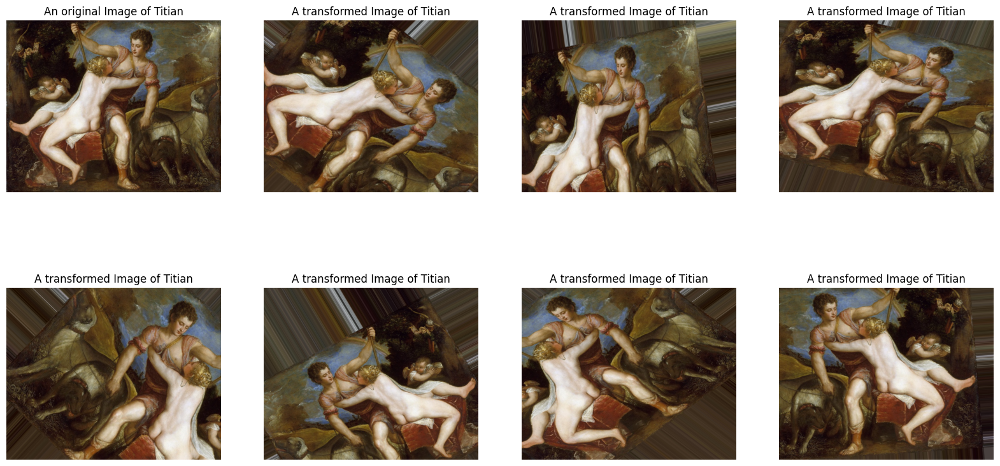

In [ ]:
fig, axes = plt.subplots(2, 4, figsize=(20,10))

# Select a random artist
random_artist = random.choice(artists_top_name)
random_image = random.choice(os.listdir(os.path.join(images_dir, random_artist)))
random_image_file = os.path.join(images_dir, random_artist, random_image)

# Original image
image = plt.imread(random_image_file)
axes[0, 0].imshow(image)
axes[0, 0].set_title("An original Image of " + random_artist.replace('_', ' '))
axes[0, 0].axis('off')

# Transformed images
for i in range(1, 8):
    row = i // 4
    col = i % 4
    aug_image = train_datagen.random_transform(image.copy())  # Apply the random transformation
    axes[row, col].imshow(aug_image)
    axes[row, col].set_title("A transformed Image of " + random_artist.replace('_', ' '))
    axes[row, col].axis('off')

plt.show()


## 2.Custom CNN

### 2.1 Model Architecture

In [ ]:
from keras.models import Sequential
from keras.layers import Conv2D, MaxPooling2D
from keras.layers import Activation, Dropout, Flatten, Dense
from keras.optimizers import Adam

model1 = Sequential()
model1.add(Conv2D(32, (3, 3), input_shape=(224, 224, 3)))
model1.add(Activation('relu'))
model1.add(MaxPooling2D(pool_size=(2, 2)))

model1.add(Conv2D(64, (3, 3)))
model1.add(Activation('relu'))
model1.add(MaxPooling2D(pool_size=(2, 2)))

model1.add(Conv2D(128, (3, 3)))
model1.add(Activation('relu'))
model1.add(MaxPooling2D(pool_size=(2, 2)))

model1.add(Flatten())
model1.add(Dense(64))
model1.add(Activation('relu'))
model1.add(Dropout(0.5))
model1.add(Dense(11)) # Number of classes
model1.add(Activation('softmax'))

model1.compile(loss='categorical_crossentropy',
              optimizer='adam',
              metrics=['accuracy'])


In [ ]:
model1.summary()

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d (Conv2D)             (None, 222, 222, 32)      896       
                                                                 
 activation (Activation)     (None, 222, 222, 32)      0         
                                                                 
 max_pooling2d (MaxPooling2D  (None, 111, 111, 32)     0         
 )                                                               
                                                                 
 conv2d_1 (Conv2D)           (None, 109, 109, 64)      18496     
                                                                 
 activation_1 (Activation)   (None, 109, 109, 64)      0         
                                                                 
 max_pooling2d_1 (MaxPooling  (None, 54, 54, 64)       0         
 2D)                                                    

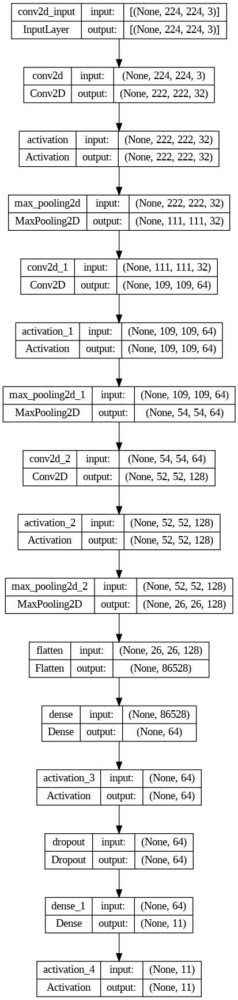

In [ ]:
from tensorflow.keras.utils import plot_model

# Plot the model
plot_model(model1, to_file='/content/drive/MyDrive/DL_Final/Models/model_cnn.png', show_shapes=True, show_layer_names=True)

### 2.2 Train the Model

In [ ]:
from tensorflow.keras.callbacks import TensorBoard

log_dir1 = "/content/drive/MyDrive/DL_Final/logs/model1"
tensorboard_callback = TensorBoard(log_dir=log_dir1, histogram_freq=1)

In [ ]:
from keras.callbacks import EarlyStopping

number_of_epochs = 20
early_stop = EarlyStopping(monitor = 'val_loss', patience =3)

In [ ]:
history1 = model1.fit(train_generator,
                    steps_per_epoch=STEP_SIZE_TRAIN,
                    validation_data=valid_generator,
                    validation_steps=STEP_SIZE_VALID,
                    epochs=number_of_epochs,
                    callbacks=[early_stop, tensorboard_callback]
)

Epoch 1/20
216/216 [==============================] - 84s 366ms/step - loss: 2.2213 - accuracy: 0.2149 - val_loss: 1.9654 - val_accuracy: 0.3054
Epoch 2/20
216/216 [==============================] - 78s 362ms/step - loss: 2.0049 - accuracy: 0.2877 - val_loss: 1.9389 - val_accuracy: 0.3101
Epoch 3/20
216/216 [==============================] - 79s 364ms/step - loss: 1.9060 - accuracy: 0.3178 - val_loss: 1.7610 - val_accuracy: 0.4033
Epoch 4/20
216/216 [==============================] - 78s 363ms/step - loss: 1.8125 - accuracy: 0.3575 - val_loss: 1.7791 - val_accuracy: 0.3703
Epoch 5/20
216/216 [==============================] - 78s 363ms/step - loss: 1.7878 - accuracy: 0.3714 - val_loss: 1.6704 - val_accuracy: 0.4175
Epoch 6/20
216/216 [==============================] - 78s 360ms/step - loss: 1.7516 - accuracy: 0.3914 - val_loss: 1.6310 - val_accuracy: 0.4210
Epoch 7/20
216/216 [==============================] - 78s 360ms/step - loss: 1.7110 - accuracy: 0.3966 - val_loss: 1.5937 - val_ac

In [ ]:
# Save model1
model_dir = '/content/drive/MyDrive/DL_Final/Models/'
model1.save(model_dir + 'model_cnn.h5')

In [ ]:
tensorboard = TensorBoard(log_dir1)
%load_ext tensorboard

In [ ]:
%tensorboard --logdir /content/drive/MyDrive/DL_Final/logs/model1 --port 6008

<IPython.core.display.Javascript object>

### 2.3 Hyper-parameter Tuning

In [ ]:
pip install keras-tuner

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 176.1/176.1 kB 3.3 MB/s eta 0:00:00


In [ ]:
from keras.optimizers import Adam
from kerastuner import HyperModel
from kerastuner.tuners import RandomSearch

class MyHyperModel(HyperModel):
    def __init__(self, input_shape, num_classes):
        self.input_shape = input_shape
        self.num_classes = num_classes

    def build(self, hp):
        model = Sequential()
        model.add(Conv2D(32, (3, 3), input_shape=self.input_shape))
        model.add(Activation('relu'))
        model.add(MaxPooling2D(pool_size=(2, 2)))

        model.add(Conv2D(64, (3, 3)))
        model.add(Activation('relu'))
        model.add(MaxPooling2D(pool_size=(2, 2)))

        model.add(Conv2D(128, (3, 3)))
        model.add(Activation('relu'))
        model.add(MaxPooling2D(pool_size=(2, 2)))

        model.add(Flatten())
        model.add(Dense(hp.Int('dense_units', min_value=32, max_value=512, step=32)))
        model.add(Activation('relu'))
        model.add(Dropout(0.5))
        model.add(Dense(self.num_classes))
        model.add(Activation('softmax'))

        model.compile(optimizer=Adam(hp.Choice('learning_rate', values=[1e-2, 1e-3, 1e-4])),
                      loss='categorical_crossentropy',
                      metrics=['accuracy'])
        return model

hypermodel = MyHyperModel(input_shape=(224, 224, 3), num_classes=11)

tuner = RandomSearch(
    hypermodel,
    objective='val_accuracy',
    max_trials=5,  # number of different hyperparameter combinations to test
    executions_per_trial=2,  # number of models to train per trial (to get more robust results)
    directory='my_dir',  # directory where the results are stored
    project_name='helloworld')  # name of the project

tuner.search(train_generator,
             validation_data=valid_generator,
             epochs=10,
             steps_per_epoch=STEP_SIZE_TRAIN,
             validation_steps=STEP_SIZE_VALID)

# Get the optimal hyperparameters
best_hps=tuner.get_best_hyperparameters(num_trials=1)[0]

# Build the model with the optimal hyperparameters
best_model = tuner.hypermodel.build(best_hps)


Trial 5 Complete [00h 25m 55s]
val_accuracy: 0.5395047068595886

Best val_accuracy So Far: 0.5395047068595886
Total elapsed time: 02h 09m 43s


In [ ]:
# Print the best hyperparameters
print(f"The best number of units in the dense layer is {best_hps.get('dense_units')}")

The best number of units in the dense layer is 384


In [ ]:
print(f"The best learning rate is {best_hps.get('learning_rate')}")

The best learning rate is 0.0001


In [ ]:
best_model.summary()

Model: "sequential_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d_3 (Conv2D)           (None, 222, 222, 32)      896       
                                                                 
 activation_5 (Activation)   (None, 222, 222, 32)      0         
                                                                 
 max_pooling2d_3 (MaxPooling  (None, 111, 111, 32)     0         
 2D)                                                             
                                                                 
 conv2d_4 (Conv2D)           (None, 109, 109, 64)      18496     
                                                                 
 activation_6 (Activation)   (None, 109, 109, 64)      0         
                                                                 
 max_pooling2d_4 (MaxPooling  (None, 54, 54, 64)       0         
 2D)                                                  

In [ ]:
log_dir2 = "/content/drive/MyDrive/DL_Final/logs/model2"
tensorboard_callback = TensorBoard(log_dir=log_dir2, histogram_freq=1)

history2 = best_model.fit(train_generator,
                    steps_per_epoch=STEP_SIZE_TRAIN,
                    validation_data=valid_generator,
                    validation_steps=STEP_SIZE_VALID,
                    epochs=number_of_epochs,
                    callbacks=[early_stop, tensorboard_callback]
)



Epoch 1/20
216/216 [==============================] - 79s 364ms/step - loss: 1.2156 - accuracy: 0.5817 - val_loss: 1.2747 - val_accuracy: 0.5436
Epoch 2/20
216/216 [==============================] - 78s 363ms/step - loss: 1.2047 - accuracy: 0.5860 - val_loss: 1.2500 - val_accuracy: 0.5708
Epoch 3/20
216/216 [==============================] - 79s 367ms/step - loss: 1.1866 - accuracy: 0.5892 - val_loss: 1.2862 - val_accuracy: 0.5601
Epoch 4/20
216/216 [==============================] - 78s 364ms/step - loss: 1.1842 - accuracy: 0.5962 - val_loss: 1.2432 - val_accuracy: 0.5708
Epoch 5/20
216/216 [==============================] - 78s 363ms/step - loss: 1.1571 - accuracy: 0.6014 - val_loss: 1.1783 - val_accuracy: 0.5943
Epoch 6/20
216/216 [==============================] - 78s 362ms/step - loss: 1.1605 - accuracy: 0.6014 - val_loss: 1.2201 - val_accuracy: 0.5613
Epoch 7/20
216/216 [==============================] - 78s 361ms/step - loss: 1.1195 - accuracy: 0.6083 - val_loss: 1.2087 - val_ac

In [ ]:
tensorboard = TensorBoard(log_dir2)
%load_ext tensorboard
%tensorboard --logdir /content/drive/MyDrive/DL_Final/logs/model2 --port 6009

The tensorboard extension is already loaded. To reload it, use:
  %reload_ext tensorboard


Reusing TensorBoard on port 6009 (pid 89053), started 0:01:56 ago. (Use '!kill 89053' to kill it.)

<IPython.core.display.Javascript object>

In [ ]:
# Save model1
model_dir = '/content/drive/MyDrive/DL_Final/Models/'
best_model.save(model_dir + 'model_cnn_tuned.h5')

### 2.4 Model Evaluation

#### 2.4.1 For Original Custom CNN:

In [ ]:
# Prediction accuracy on train data
score = model1.evaluate_generator(train_generator, verbose=1)
print("Prediction accuracy on train data =", score[1])

217/217 [==============================] - 63s 292ms/step - loss: 1.4120 - accuracy: 0.5115
Prediction accuracy on train data = 0.5115340352058411


In [ ]:
# Prediction accuracy on CV data
score = model1.evaluate_generator(valid_generator, verbose=1)
print("Prediction accuracy on CV data =", score[1])

54/54 [==============================] - 16s 292ms/step - loss: 1.5601 - accuracy: 0.4506
Prediction accuracy on CV data = 0.4506388008594513


#### 2.4.2 For Tuned CNN:

In [ ]:
# Prediction accuracy on train data
score = best_model.evaluate_generator(train_generator, verbose=1)
print("Prediction accuracy on train data =", score[1])

217/217 [==============================] - 62s 286ms/step - loss: 0.9784 - accuracy: 0.6583
Prediction accuracy on train data = 0.6583045125007629


In [ ]:
# Prediction accuracy on CV data
score = best_model.evaluate_generator(valid_generator, verbose=1)
print("Prediction accuracy on CV data =", score[1])

54/54 [==============================] - 15s 281ms/step - loss: 1.2069 - accuracy: 0.5761
Prediction accuracy on CV data = 0.5760743618011475


1/1 [==============================] - 0s 23ms/step


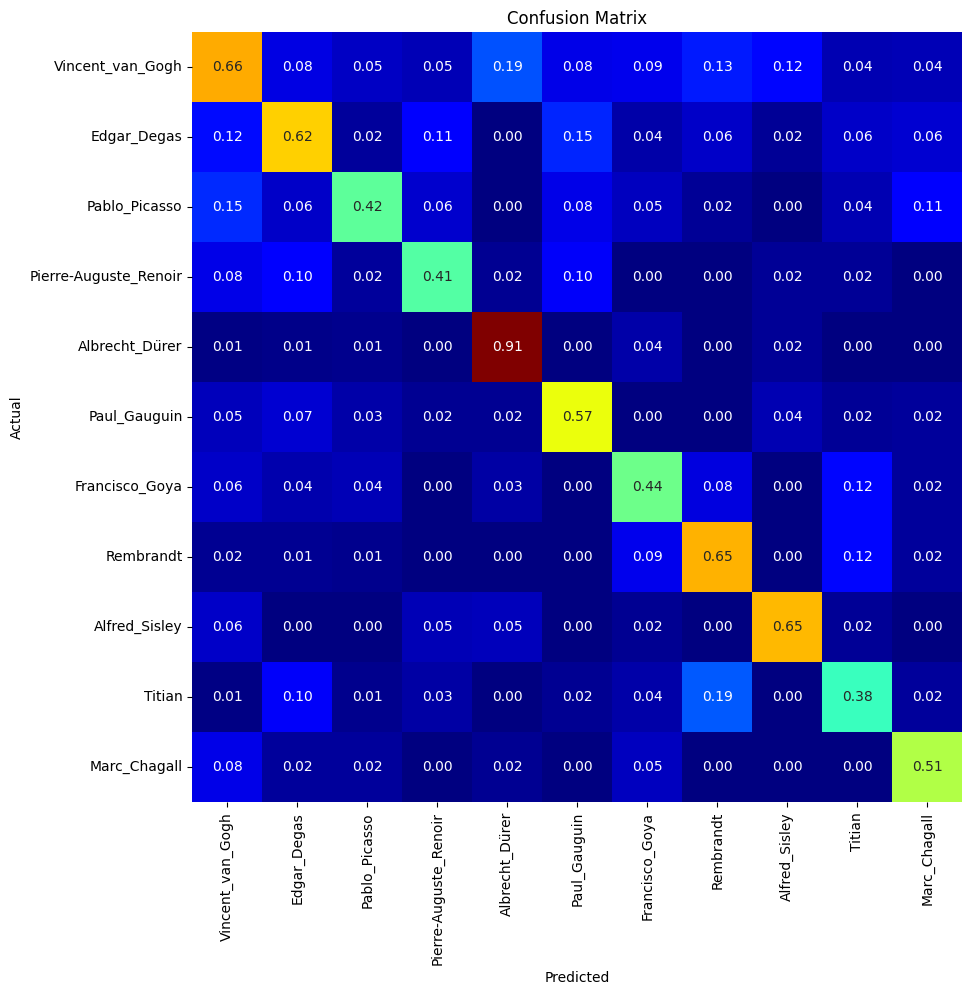

Classification Report:
                       precision    recall  f1-score   support

     Vincent_van_Gogh       0.51      0.66      0.58       171
          Edgar_Degas       0.56      0.62      0.59       136
        Pablo_Picasso       0.65      0.42      0.51        93
Pierre-Auguste_Renoir       0.57      0.41      0.48        66
      Albrecht_Dürer       0.74      0.91      0.82        64
         Paul_Gauguin       0.57      0.57      0.57        61
       Francisco_Goya       0.52      0.44      0.48        57
            Rembrandt       0.58      0.65      0.61        52
        Alfred_Sisley       0.75      0.65      0.69        51
               Titian       0.46      0.38      0.42        50
         Marc_Chagall       0.63      0.51      0.56        47

             accuracy                           0.58       848
            macro avg       0.60      0.57      0.57       848
         weighted avg       0.58      0.58      0.57       848



In [ ]:
# Classification report and confusion matrix
from sklearn.metrics import *
import seaborn as sns

tick_labels = artists_top_name.tolist()

def showClassficationReport_Generator(model, valid_generator, STEP_SIZE_VALID):
    # Loop on each generator batch and predict
    y_pred, y_true = [], []
    for i in range(STEP_SIZE_VALID):
        (X,y) = next(valid_generator)
        y_pred.append(model.predict(X))
        y_true.append(y)

    # Create a flat list for y_true and y_pred
    y_pred = [subresult for result in y_pred for subresult in result]
    y_true = [subresult for result in y_true for subresult in result]

    # Update Truth vector based on argmax
    y_true = np.argmax(y_true, axis=1)
    y_true = np.asarray(y_true).ravel()

    # Update Prediction vector based on argmax
    y_pred = np.argmax(y_pred, axis=1)
    y_pred = np.asarray(y_pred).ravel()

    # Confusion Matrix
    fig, ax = plt.subplots(figsize=(10,10))
    conf_matrix = confusion_matrix(y_true, y_pred, labels=np.arange(n_classes))
    conf_matrix = conf_matrix/np.sum(conf_matrix, axis=1)
    sns.heatmap(conf_matrix, annot=True, fmt=".2f", square=True, cbar=False,
                cmap=plt.cm.jet, xticklabels=tick_labels, yticklabels=tick_labels,
                ax=ax)
    ax.set_ylabel('Actual')
    ax.set_xlabel('Predicted')
    ax.set_title('Confusion Matrix')
    plt.show()

    print('Classification Report:')
    print(classification_report(y_true, y_pred, labels=np.arange(n_classes), target_names=artists_top_name.tolist()))

showClassficationReport_Generator(best_model, valid_generator, STEP_SIZE_VALID)

## 3.Transfer Learning

### 3.1 Phase1: Full Model Traning

In [ ]:
# Load pre-trained model
base_model = ResNet50(weights='imagenet', include_top=False, input_shape=train_input_shape)

for layer in base_model.layers:
    layer.trainable = True

94765736/94765736 [==============================] - 5s 0us/step


#### 3.1.1 Model Architecture

In [ ]:
# Add layers at the end
X = base_model.output
X = Flatten()(X)

X = Dense(512, kernel_initializer='he_uniform')(X)
#X = Dropout(0.5)(X)
X = BatchNormalization()(X)
X = Activation('relu')(X)

X = Dense(16, kernel_initializer='he_uniform')(X)
#X = Dropout(0.5)(X)
X = BatchNormalization()(X)
X = Activation('relu')(X)

output = Dense(n_classes, activation='softmax')(X)

model2 = Model(inputs=base_model.input, outputs=output)

In [ ]:
optimizer = Adam(lr=0.0001)
model2.compile(loss='categorical_crossentropy',
              optimizer=optimizer,
              metrics=['accuracy'])

In [ ]:
n_epoch = 20
early_stop = EarlyStopping(monitor='val_loss', patience=20, verbose=2,
                           mode='auto', restore_best_weights=True)
reduce_lr = ReduceLROnPlateau(monitor='val_loss', factor=0.1, patience=5,
                              verbose=1, mode='auto')

#### 3.1.2 Train the Model

In [ ]:
log_dir3 = "/content/drive/MyDrive/DL_Final/logs/model3"
tensorboard_callback = TensorBoard(log_dir=log_dir3, histogram_freq=1)

history3 = model2.fit_generator(generator=train_generator,
                                steps_per_epoch=STEP_SIZE_TRAIN,
                                validation_data=valid_generator,
                                validation_steps=STEP_SIZE_VALID,
                                epochs=n_epoch,
                                shuffle=True,
                                verbose=1,
                                callbacks=[reduce_lr, early_stop, tensorboard_callback],
                                use_multiprocessing=True,
                                workers=16,
                                class_weight=class_weights
                             )


Epoch 1/20
216/216 [==============================] - 43s 176ms/step - loss: 1.2600 - accuracy: 0.5753 - val_loss: 3.9483 - val_accuracy: 0.0531 - lr: 1.0000e-04
Epoch 2/20
216/216 [==============================] - 43s 178ms/step - loss: 1.1501 - accuracy: 0.6419 - val_loss: 2.5610 - val_accuracy: 0.1710 - lr: 1.0000e-04
Epoch 3/20
216/216 [==============================] - 44s 179ms/step - loss: 1.0301 - accuracy: 0.6912 - val_loss: 2.1420 - val_accuracy: 0.3455 - lr: 1.0000e-04
Epoch 4/20
216/216 [==============================] - 43s 178ms/step - loss: 0.9675 - accuracy: 0.7291 - val_loss: 1.3402 - val_accuracy: 0.6132 - lr: 1.0000e-04
Epoch 5/20
216/216 [==============================] - 43s 177ms/step - loss: 0.8807 - accuracy: 0.7929 - val_loss: 1.0775 - val_accuracy: 0.7583 - lr: 1.0000e-04
Epoch 6/20
216/216 [==============================] - 39s 158ms/step - loss: 0.7858 - accuracy: 0.8276 - val_loss: 1.0930 - val_accuracy: 0.7547 - lr: 1.0000e-04
Epoch 7/20
216/216 [========

In [ ]:
tensorboard = TensorBoard(log_dir3)
%load_ext tensorboard
%tensorboard --logdir /content/drive/MyDrive/DL_Final/logs/model3 --port 6010

The tensorboard extension is already loaded. To reload it, use:
  %reload_ext tensorboard


<IPython.core.display.Javascript object>

In [ ]:
# Save model1
model_dir = '/content/drive/MyDrive/DL_Final/Models/'
model2.save(model_dir + 'model_resnet1.h5')

### 3.2 Phase2: Fine Tuning

#### 3.2.1 Model Architecture

In [ ]:
# Freeze core ResNet layers and train again
for layer in model2.layers:
    layer.trainable = False

for layer in model2.layers[:50]:
    layer.trainable = True

optimizer = Adam(lr=0.0001)

model2.compile(loss='categorical_crossentropy',
              optimizer=optimizer,
              metrics=['accuracy'])

#### 3.2.2 Train the Model

In [ ]:
log_dir4 = "/content/drive/MyDrive/DL_Final/logs/model4"
tensorboard_callback = TensorBoard(log_dir=log_dir4, histogram_freq=1)

history4 = model2.fit_generator(generator=train_generator,
                                steps_per_epoch=STEP_SIZE_TRAIN,
                                validation_data=valid_generator,
                                validation_steps=STEP_SIZE_VALID,
                                epochs=n_epoch,
                                shuffle=True,
                                verbose=1,
                                callbacks=[reduce_lr, early_stop, tensorboard_callback],
                                use_multiprocessing=True,
                                workers=16,
                                class_weight=class_weights
                             )


Epoch 1/20
216/216 [==============================] - 52s 199ms/step - loss: 0.1502 - accuracy: 0.9725 - val_loss: 0.6384 - val_accuracy: 0.8290 - lr: 1.0000e-04
Epoch 2/20
216/216 [==============================] - 44s 183ms/step - loss: 0.1359 - accuracy: 0.9783 - val_loss: 0.5726 - val_accuracy: 0.8420 - lr: 1.0000e-04
Epoch 3/20
216/216 [==============================] - 41s 166ms/step - loss: 0.1203 - accuracy: 0.9794 - val_loss: 0.5983 - val_accuracy: 0.8349 - lr: 1.0000e-04
Epoch 4/20
216/216 [==============================] - 46s 188ms/step - loss: 0.1131 - accuracy: 0.9809 - val_loss: 0.5999 - val_accuracy: 0.8349 - lr: 1.0000e-04
Epoch 5/20
216/216 [==============================] - 45s 186ms/step - loss: 0.1143 - accuracy: 0.9829 - val_loss: 0.6006 - val_accuracy: 0.8302 - lr: 1.0000e-04
Epoch 6/20
216/216 [==============================] - 46s 189ms/step - loss: 0.1076 - accuracy: 0.9826 - val_loss: 0.6010 - val_accuracy: 0.8208 - lr: 1.0000e-04
Epoch 7/20
216/216 [========

In [ ]:
tensorboard = TensorBoard(log_dir4)
%load_ext tensorboard
%tensorboard --logdir /content/drive/MyDrive/DL_Final/logs/model4 --port 6011

The tensorboard extension is already loaded. To reload it, use:
  %reload_ext tensorboard


<IPython.core.display.Javascript object>

In [ ]:
# Save model1
model_dir = '/content/drive/MyDrive/DL_Final/Models/'
model2.save(model_dir + 'model_resnet.h5')

### 3.3 Model Evaluation

In [ ]:
# Prediction accuracy on train data
score = model2.evaluate_generator(train_generator, verbose=1)
print("Prediction accuracy on train data =", score[1])

217/217 [==============================] - 67s 307ms/step - loss: 0.1071 - accuracy: 0.9937
Prediction accuracy on train data = 0.9936562776565552


In [ ]:
# Prediction accuracy on CV data
score = model2.evaluate_generator(valid_generator, verbose=1)
print("Prediction accuracy on CV data =", score[1])

54/54 [==============================] - 17s 309ms/step - loss: 0.5340 - accuracy: 0.8571
Prediction accuracy on CV data = 0.8571428656578064


1/1 [==============================] - 0s 30ms/step


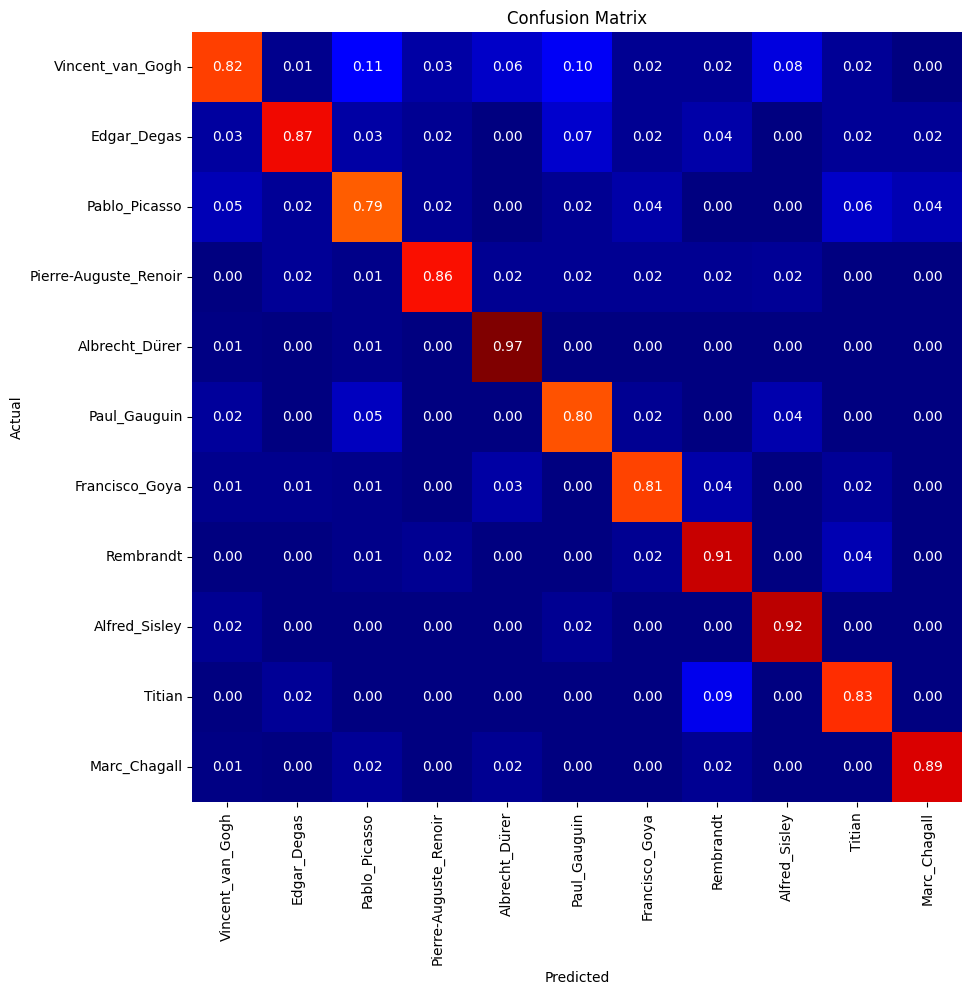

Classification Report:
                       precision    recall  f1-score   support

     Vincent_van_Gogh       0.85      0.82      0.83       170
          Edgar_Degas       0.90      0.87      0.89       141
        Pablo_Picasso       0.76      0.79      0.77        94
Pierre-Auguste_Renoir       0.92      0.86      0.89        66
      Albrecht_Dürer       0.89      0.97      0.93        65
         Paul_Gauguin       0.78      0.80      0.79        59
       Francisco_Goya       0.86      0.81      0.83        53
            Rembrandt       0.80      0.91      0.85        53
        Alfred_Sisley       0.87      0.92      0.89        50
               Titian       0.83      0.83      0.83        48
         Marc_Chagall       0.93      0.89      0.91        46

             accuracy                           0.85       845
            macro avg       0.85      0.86      0.86       845
         weighted avg       0.85      0.85      0.85       845



In [ ]:
# Classification report and confusion matrix
from sklearn.metrics import *
import seaborn as sns

tick_labels = artists_top_name.tolist()

def showClassficationReport_Generator(model, valid_generator, STEP_SIZE_VALID):
    # Loop on each generator batch and predict
    y_pred, y_true = [], []
    for i in range(STEP_SIZE_VALID):
        (X,y) = next(valid_generator)
        y_pred.append(model.predict(X))
        y_true.append(y)

    # Create a flat list for y_true and y_pred
    y_pred = [subresult for result in y_pred for subresult in result]
    y_true = [subresult for result in y_true for subresult in result]

    # Update Truth vector based on argmax
    y_true = np.argmax(y_true, axis=1)
    y_true = np.asarray(y_true).ravel()

    # Update Prediction vector based on argmax
    y_pred = np.argmax(y_pred, axis=1)
    y_pred = np.asarray(y_pred).ravel()

    # Confusion Matrix
    fig, ax = plt.subplots(figsize=(10,10))
    conf_matrix = confusion_matrix(y_true, y_pred, labels=np.arange(n_classes))
    conf_matrix = conf_matrix/np.sum(conf_matrix, axis=1)
    sns.heatmap(conf_matrix, annot=True, fmt=".2f", square=True, cbar=False,
                cmap=plt.cm.jet, xticklabels=tick_labels, yticklabels=tick_labels,
                ax=ax)
    ax.set_ylabel('Actual')
    ax.set_xlabel('Predicted')
    ax.set_title('Confusion Matrix')
    plt.show()

    print('Classification Report:')
    print(classification_report(y_true, y_pred, labels=np.arange(n_classes), target_names=artists_top_name.tolist()))

showClassficationReport_Generator(model2, valid_generator, STEP_SIZE_VALID)

## 4.Classification Result

### 4.1 Prediction Result on a random image

1/1 [==============================] - 0s 26ms/step


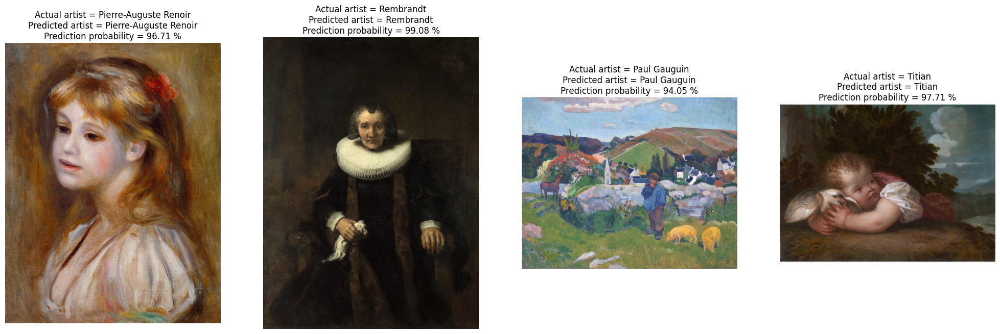

In [ ]:
from tensorflow.keras.preprocessing.image import load_img, img_to_array
from keras.preprocessing import *

n = 4
fig, axes = plt.subplots(1, n, figsize=(25,10))

for i in range(n):
    random_artist = random.choice(artists_top_name)
    random_image = random.choice(os.listdir(os.path.join(images_dir, random_artist)))
    random_image_file = os.path.join(images_dir, random_artist, random_image)

    # Original image

    test_image = load_img(random_image_file, target_size=(train_input_shape[0:2]))

    # Predict artist
    test_image = img_to_array(test_image)
    test_image /= 255.
    test_image = np.expand_dims(test_image, axis=0)

    prediction = model2.predict(test_image)
    prediction_probability = np.amax(prediction)
    prediction_idx = np.argmax(prediction)

    labels = train_generator.class_indices
    labels = dict((v,k) for k,v in labels.items())

    #print("Actual artist =", random_artist.replace('_', ' '))
    #print("Predicted artist =", labels[prediction_idx].replace('_', ' '))
    #print("Prediction probability =", prediction_probability*100, "%")

    title = "Actual artist = {}\nPredicted artist = {}\nPrediction probability = {:.2f} %" \
                .format(random_artist.replace('_', ' '), labels[prediction_idx].replace('_', ' '),
                        prediction_probability*100)

    # Print image
    axes[i].imshow(plt.imread(random_image_file))
    axes[i].set_title(title)
    axes[i].axis('off')

plt.show()